## Get the Data
Follow this link to run the query from [StackExchange](https://data.stackexchange.com/stackoverflow/query/675441/popular-programming-languages-per-over-time-eversql-com) to get your own .csv file

<code>
select dateadd(month, datediff(month, 0, q.CreationDate), 0) m, TagName, count(*)
from PostTags pt
join Posts q on q.Id=pt.PostId
join Tags t on t.Id=pt.TagId
where TagName in ('java','c','c++','python','c#','javascript','assembly','php','perl','ruby','visual basic','swift','r','object-c','scratch','go','swift','delphi')
and q.CreationDate < dateadd(month, datediff(month, 0, getdate()), 0)
group by dateadd(month, datediff(month, 0, q.CreationDate), 0), TagName
order by dateadd(month, datediff(month, 0, q.CreationDate), 0)
</code>

## Import Statements

In [1]:
import pandas as pd

## Data Exploration

**Challenge**: Read the .csv file and store it in a Pandas dataframe

In [8]:
df = pd.read_csv('QueryResults.csv', header=0, names = ['DATE', 'TAG', 'POSTS'])

**Challenge**: Examine the first 5 rows and the last 5 rows of the of the dataframe

In [9]:
df.head()

,DATE,TAG,POSTS
0,2008-07-01 00:00:00,c#,3
1,2008-08-01 00:00:00,assembly,8
2,2008-08-01 00:00:00,c,83
3,2008-08-01 00:00:00,c#,505
4,2008-08-01 00:00:00,c++,164


In [10]:
df.tail()

,DATE,TAG,POSTS
2477,2023-06-01 00:00:00,php,2399
2478,2023-06-01 00:00:00,python,12919
2479,2023-06-01 00:00:00,r,2821
2480,2023-06-01 00:00:00,ruby,254
2481,2023-06-01 00:00:00,swift,1280


**Challenge:** Check how many rows and how many columns there are.
What are the dimensions of the dataframe?

In [11]:
df.shape

(2482, 3)

**Challenge**: Count the number of entries in each column of the dataframe

In [13]:
df.count()

DATE     2482
TAG      2482
POSTS    2482
dtype: int64

**Challenge**: Calculate the total number of post per language.
Which Programming language has had the highest total number of posts of all time?

In [18]:
df.groupby('TAG').sum('POSTS').sort_values('POSTS', ascending=False)

,POSTS
TAG,
javascript,2500729
python,2145468
java,1900407
c#,1595224
php,1459606
c++,795693
r,492637
c,397344
swift,328246


Some languages are older (e.g., C) and other languages are newer (e.g., Swift). The dataset starts in September 2008.

**Challenge**: How many months of data exist per language? Which language had the fewest months with an entry?


In [20]:
df.groupby('TAG').count().sort_values('DATE', ascending=False)

,DATE,POSTS
TAG,,
c#,180,180
assembly,179,179
c,179,179
c++,179,179
delphi,179,179
java,179,179
javascript,179,179
perl,179,179
php,179,179


## Data Cleaning

Let's fix the date format to make it more readable. We need to use Pandas to change format from a string of "2008-07-01 00:00:00" to a datetime object with the format of "2008-07-01"

In [23]:
type(df.DATE[1])

str

In [24]:
df.DATE = pd.to_datetime(df.DATE)

In [27]:
print(type(df.DATE[1]))
df.head()

<class 'pandas._libs.tslibs.timestamps.Timestamp'>


,DATE,TAG,POSTS
0,2008-07-01,c#,3
1,2008-08-01,assembly,8
2,2008-08-01,c,83
3,2008-08-01,c#,505
4,2008-08-01,c++,164


## Data Manipulation



In [33]:
reshaped_df = df.pivot(index='DATE', columns='TAG', values='POSTS')

**Challenge**: What are the dimensions of our new dataframe? How many rows and columns does it have? Print out the column names and print out the first 5 rows of the dataframe.

In [34]:
reshaped_df.shape

(180, 14)

In [39]:
reshaped_df.columns

Index(['assembly', 'c', 'c#', 'c++', 'delphi', 'go', 'java', 'javascript',
       'perl', 'php', 'python', 'r', 'ruby', 'swift'],
      dtype='object', name='TAG')

In [35]:
reshaped_df.head()

TAG,assembly,c,c#,c++,delphi,go,java,javascript,perl,php,python,r,ruby,swift
DATE,,,,,,,,,,,,,,
2008-07-01,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2008-08-01,8.0,83.0,505.0,164.0,14.0,NaN,222.0,163.0,28.0,158.0,120.0,NaN,70.0,NaN
2008-09-01,28.0,320.0,1641.0,754.0,104.0,NaN,1129.0,634.0,130.0,475.0,536.0,6.0,287.0,NaN
2008-10-01,16.0,302.0,1988.0,807.0,112.0,NaN,1149.0,722.0,128.0,610.0,506.0,NaN,247.0,NaN
2008-11-01,16.0,258.0,1731.0,734.0,141.0,NaN,956.0,580.0,97.0,499.0,449.0,1.0,157.0,NaN


In [36]:
reshaped_df.tail()

TAG,assembly,c,c#,c++,delphi,go,java,javascript,perl,php,python,r,ruby,swift
DATE,,,,,,,,,,,,,,
2023-02-01,189.0,1310.0,4767.0,2224.0,133.0,660.0,5195.0,10452.0,79.0,2430.0,15738.0,3805.0,340.0,1297.0
2023-03-01,180.0,1267.0,4917.0,2575.0,142.0,639.0,5547.0,10558.0,95.0,2285.0,15588.0,3835.0,301.0,1371.0
2023-04-01,198.0,1193.0,3856.0,1975.0,121.0,518.0,4512.0,8330.0,56.0,1942.0,12459.0,3110.0,220.0,1101.0
2023-05-01,177.0,1056.0,3862.0,1792.0,116.0,429.0,4214.0,7836.0,54.0,1987.0,11866.0,2873.0,257.0,1006.0
2023-06-01,173.0,1016.0,4243.0,2176.0,132.0,614.0,5047.0,8689.0,64.0,2399.0,12919.0,2821.0,254.0,1280.0


**Challenge**: Count the number of entries per programming language. Why might the number of entries be different?

In [37]:
reshaped_df.count()

TAG
assembly      179
c             179
c#            180
c++           179
delphi        179
go            164
java          179
javascript    179
perl          179
php           179
python        179
r             177
ruby          179
swift         171
dtype: int64

In [40]:
reshaped_df.fillna(0, inplace=True)

In [41]:
reshaped_df.head()

TAG,assembly,c,c#,c++,delphi,go,java,javascript,perl,php,python,r,ruby,swift
DATE,,,,,,,,,,,,,,
2008-07-01,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2008-08-01,8.0,83.0,505.0,164.0,14.0,0.0,222.0,163.0,28.0,158.0,120.0,0.0,70.0,0.0
2008-09-01,28.0,320.0,1641.0,754.0,104.0,0.0,1129.0,634.0,130.0,475.0,536.0,6.0,287.0,0.0
2008-10-01,16.0,302.0,1988.0,807.0,112.0,0.0,1149.0,722.0,128.0,610.0,506.0,0.0,247.0,0.0
2008-11-01,16.0,258.0,1731.0,734.0,141.0,0.0,956.0,580.0,97.0,499.0,449.0,1.0,157.0,0.0


In [42]:
reshaped_df.count()

TAG
assembly      180
c             180
c#            180
c++           180
delphi        180
go            180
java          180
javascript    180
perl          180
php           180
python        180
r             180
ruby          180
swift         180
dtype: int64

## Data Visualisaton with with Matplotlib


**Challenge**: Use the [matplotlib documentation](https://matplotlib.org/3.2.1/api/_as_gen/matplotlib.pyplot.plot.html#matplotlib.pyplot.plot) to plot a single programming language (e.g., java) on a chart.

In [43]:
import matplotlib.pyplot as plt

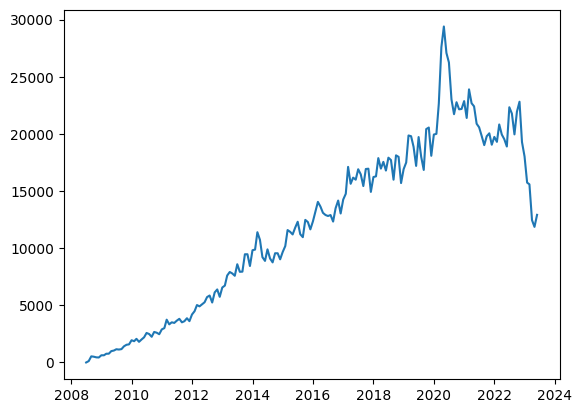

In [52]:
plt.plot(reshaped_df.index, reshaped_df.python)

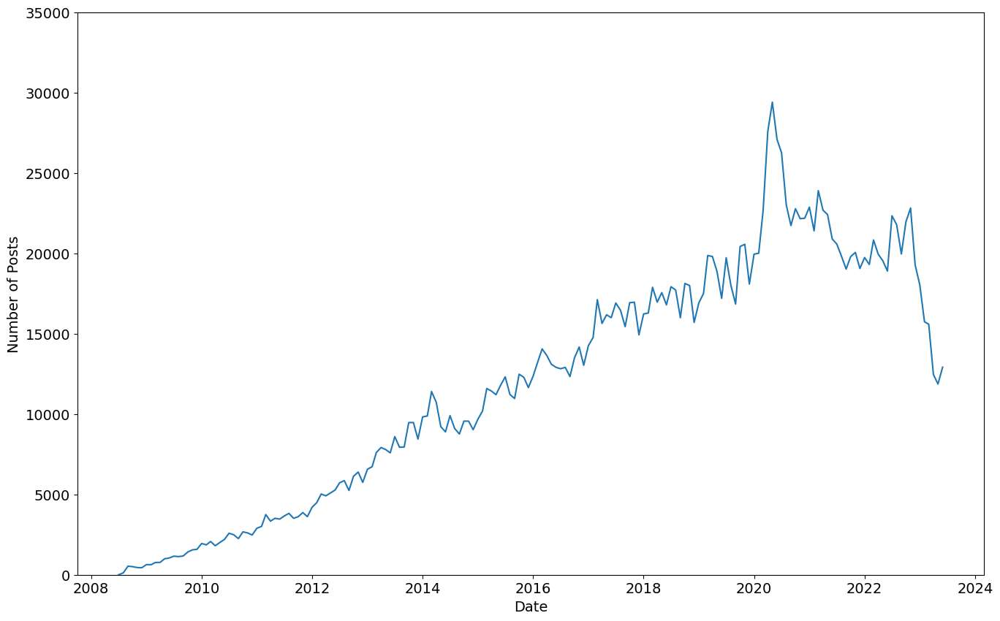

In [66]:
plt.figure(figsize=(16,10))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Date',fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0,35000)
plt.plot(reshaped_df.index, reshaped_df.python)

**Challenge**: Show two line (e.g. for Java and Python) on the same chart.

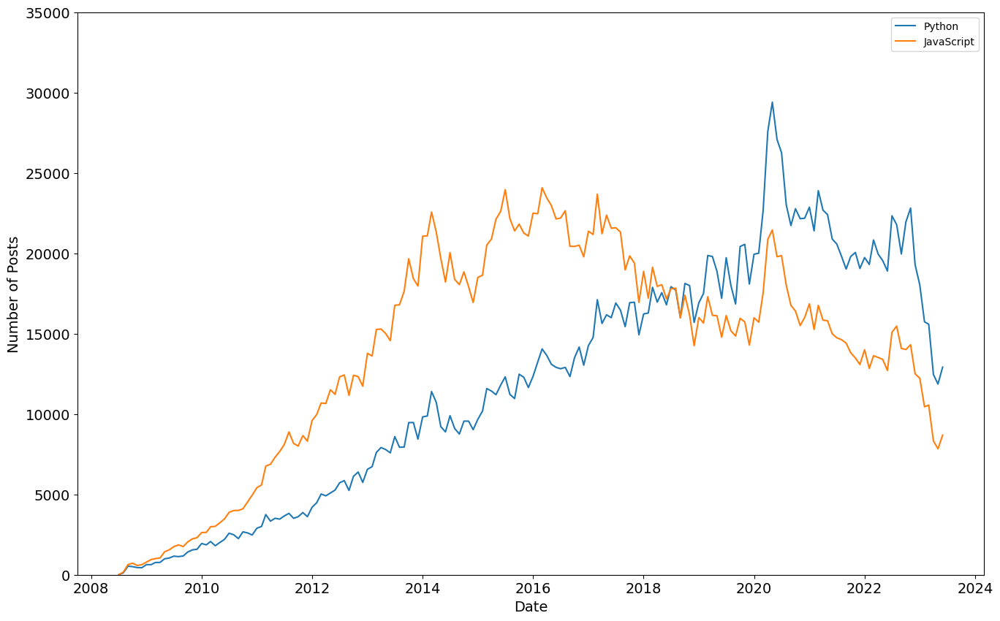

In [67]:
plt.figure(figsize=(16,10))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Date',fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0,35000)
plt.plot(reshaped_df.index, reshaped_df.python)
plt.plot(reshaped_df.index, reshaped_df.javascript)
plt.legend(['Python', 'JavaScript'], loc ="upper right")

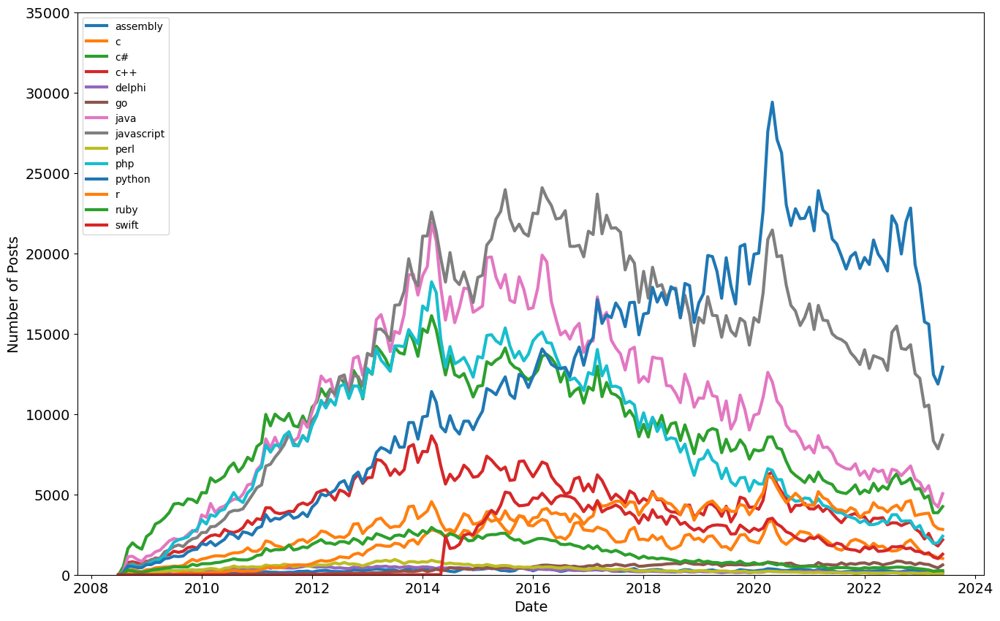

In [69]:
plt.figure(figsize=(16,10))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Date',fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0,35000)

for i in reshaped_df.columns:
  plt.plot(reshaped_df.index, reshaped_df[i], linewidth=3)
plt.legend(reshaped_df.columns, loc='upper left')

# Smoothing out Time Series Data

Time series data can be quite noisy, with a lot of up and down spikes. To better see a trend we can plot an average of, say 6 or 12 observations. This is called the rolling mean. We calculate the average in a window of time and move it forward by one overservation. Pandas has two handy methods already built in to work this out: [rolling()](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.rolling.html) and [mean()](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.core.window.rolling.Rolling.mean.html).

In [70]:
roll_df = reshaped_df.rolling(window=6).mean()

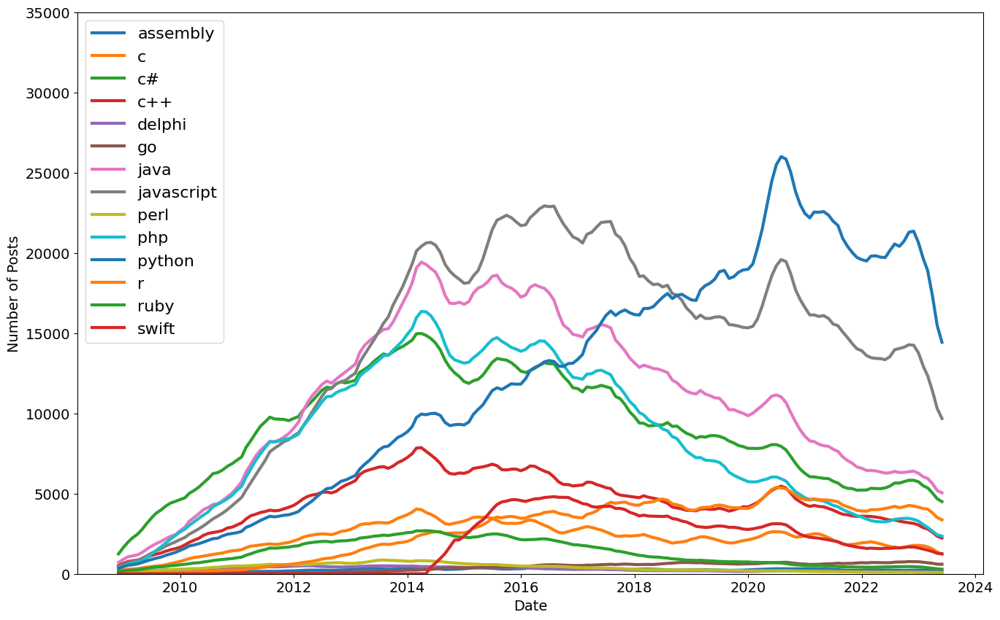

In [71]:
plt.figure(figsize=(16,10))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0, 35000)

# plot the roll_df instead
for column in roll_df.columns:
    plt.plot(roll_df.index, roll_df[column],
             linewidth=3, label=roll_df[column].name)

plt.legend(fontsize=16)

In [74]:
roll_df_12 = reshaped_df.rolling(window=12).mean()

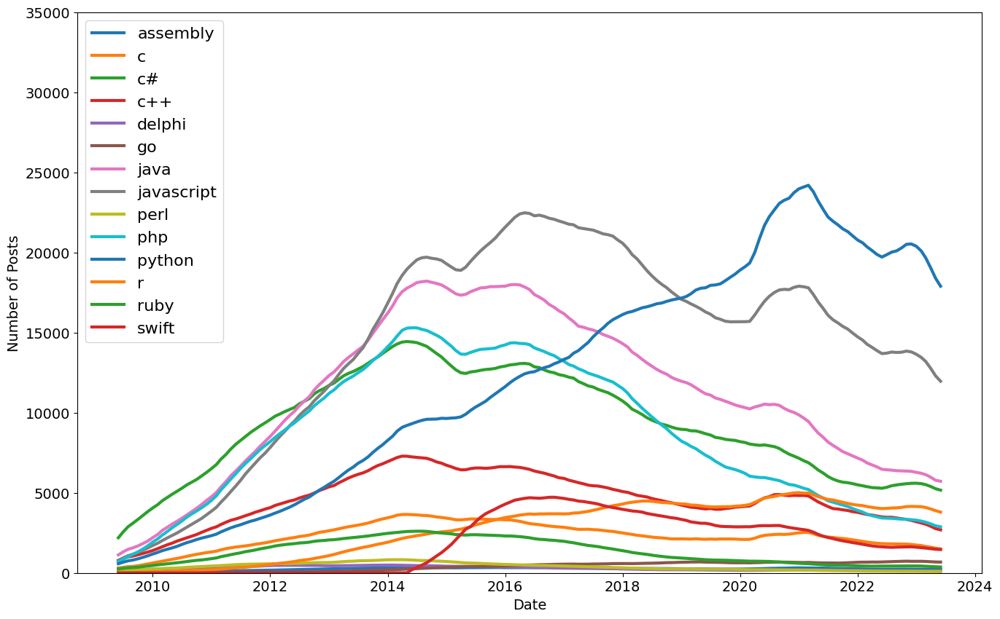

In [75]:
plt.figure(figsize=(16,10))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0, 35000)

# plot the roll_df instead
for column in roll_df_12.columns:
    plt.plot(roll_df_12.index, roll_df_12[column],
             linewidth=3, label=roll_df_12[column].name)

plt.legend(fontsize=16)

In [76]:
roll_df_3 = reshaped_df.rolling(window=3).mean()

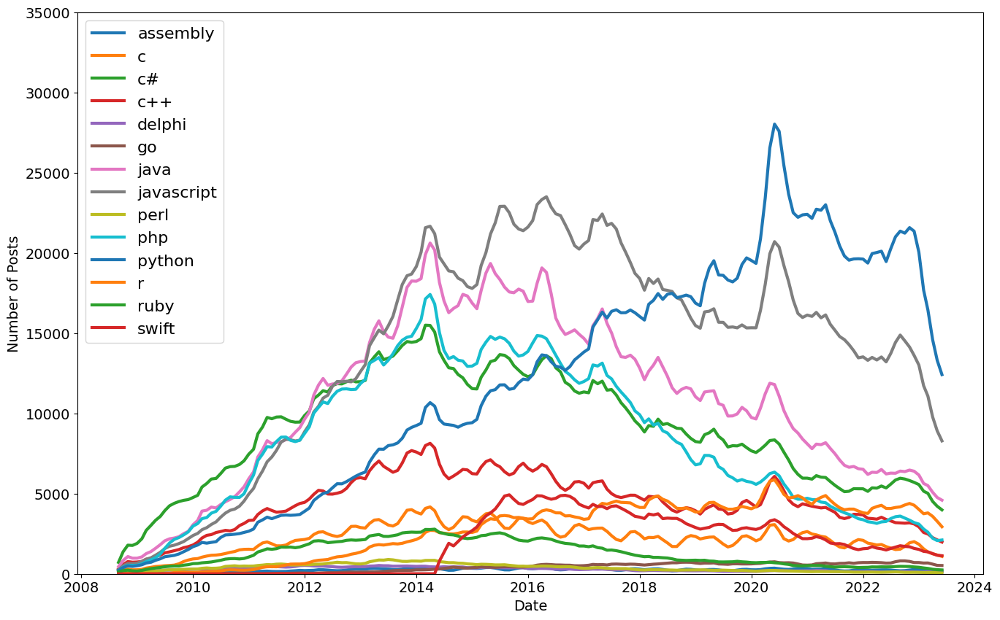

In [77]:
plt.figure(figsize=(16,10))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Posts', fontsize=14)
plt.ylim(0, 35000)

# plot the roll_df instead
for column in roll_df_3.columns:
    plt.plot(roll_df_3.index, roll_df_3[column],
             linewidth=3, label=roll_df_3[column].name)

plt.legend(fontsize=16)

# Some Extra Works  
Well, on top of the above, I was thinking a **bar or line chart race** will better display the changes in "popularity" of a programming language in terms of their posts in each period.  
So, I thought about two ways of doing this:
1. D3.js
2. matplotlib.animation✅(since we are learning data science w/ Python!)

In [85]:
import matplotlib.animation as animation
from IPython.display import HTML

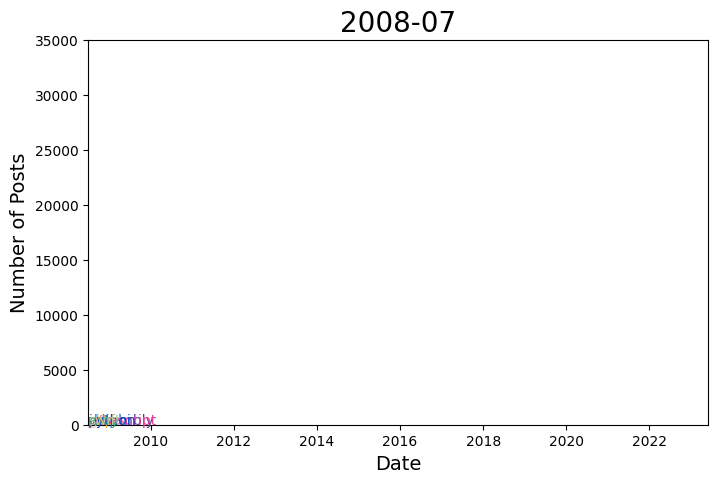

In [158]:
fig, ax = plt.subplots(figsize=(8, 5))
colors = ['#5639A6', '#20236D', '#FA4848', '#FFE087', '#0779E4', '#EECCB4', '#77D8D8', '#F6378F', '#D83C65', '#F3A953', '#064ACB', '#604CC3', '#2AAF74', '#B5C99A']

def draw_frame(frame):
    frame_df = reshaped_df[reshaped_df.index <= frame]
    ax.clear()
    ax.set_xlabel('Date', fontsize=14)
    ax.set_ylabel('Number of Posts', fontsize=14)
    ax.set_ylim(0, 35000)
    ax.set_xlim(reshaped_df.index[0], reshaped_df.index[-1])
    ax.set_title(str(frame).split()[0][:7], fontsize=20)

    for column, color in zip(frame_df.columns, colors):
        ax.plot(frame_df.index, frame_df[column],
                linewidth=3, label=frame_df[column].name, color=color)
        ax.text(x=frame_df.index[-1], y=frame_df[column][-1], s=column, color=color)


ani = animation.FuncAnimation(fig=fig, func=draw_frame, frames=reshaped_df.index)
# draw_frame(reshaped_df.index[19])
HTML(ani.to_jshtml())